# Transformaciones Geométricas

En este notebook aprenderás a implementar transformaciones geométricas sobre una imagen.

## Rotación

Operaciones comunes en visión artificial son transformar las imágenes. Veamos como rotamos una imagen usando una matriz de transformación e
interpolación bilineal.

In [1]:
import cv2
import numpy as np
import math
import plotly.express as px
import plotly

In [2]:
!wget https://github.com/diplomado-ia-pucp/dava/raw/main/cameraman.tif

"wget" no se reconoce como un comando interno o externo,
programa o archivo por lotes ejecutable.


In [3]:
def interpolar(I, coord):
    if coord[0] < 0 or coord[0] > (I.shape[1]-1) or coord[1] < 0 or coord[1] > (I.shape[0] - 1):
        return 0

    minx = math.floor(coord[0])
    maxx = math.ceil(coord[0])
    miny = math.floor(coord[1])
    maxy = math.ceil(coord[1])

    dx = coord[0] - minx
    dy = coord[1] - miny

    val1 = I[miny,minx]
    val2 = I[miny,maxx]
    val3 = I[maxy,maxx]
    val4 = I[maxy,minx]

    val11 = val1*(1-dx) + dx*val2
    val22 = val4*(1-dx) + dx*val3

    return val22*(1-dy) + dy*val11

def rotarImagen(I, centro, angulo, dim_salida):
    salida = np.zeros(dim_salida, dtype=np.uint8)
    angle = np.radians(angulo)

    T1 = np.array([[1.0, 0.0, -centro[0]]
                   ,[0.0, 1.0, -centro[1]]
                   ,[0.0, 0.0, 1.0]])
    T2 = np.array([[np.cos(angle), np.sin(angle), 0.0]
                   ,[-np.sin(angle), np.cos(angle), 0.0]
                   ,[0.0, 0.0, 1.0]])
    T3 = np.array([[1.0, 0.0, centro[0]]
                   ,[0.0, 1.0, centro[1]]
                   ,[0.0, 0.0, 1.0]])

    T4 = np.array([[3.0, 0.0, 0.0]
                   ,[0.0, 3.0, 0.0]
                   ,[0.0, 0.0, 1.0]])

    T = T4 @ T3 @ T2 @ T1
    #T = T1
    T = np.linalg.inv(T) # T^-1

    #Iteramos sobre las posiciones de la salida
    for i in range(salida.shape[0]):
        for j in range(salida.shape[1]):
            coord = np.zeros((3,1), dtype=np.float64) # [x,y,1]
            coord[0] = j
            coord[1] = i
            coord[2] = 1.0
            new_coord = T @ coord
            salida[i,j] = interpolar(I, new_coord)

    return salida

In [4]:
im = cv2.imread('cameraman.tif',0)

rows, cols = im.shape

im2 = rotarImagen(im, centro=(cols/2, rows/2), angulo=60, dim_salida=(rows*3, cols*3))

#output = np.concatenate((im, im2), axis=1)
#px.imshow(output, binary_string=True).show()

px.imshow(im, binary_string=True).show()
px.imshow(im2, binary_string=True).show()

Podemos aplicar implementaciones más eficientes como las de OpenCV. Por ejemplo, veamos cómo escalar y rotar una imagen.

In [5]:
img = cv2.imread('cameraman.tif')
print('Original shape:', img.shape)

result = cv2.resize(img, None, fx=3, fy=3, interpolation=cv2.INTER_CUBIC)
print('Resized shape:', result.shape)

px.imshow(result, binary_string=True).show()

Original shape: (256, 256, 3)
Resized shape: (768, 768, 3)


Y la operación de rotación.

In [6]:
rows, cols, _ = img.shape

M = cv2.getRotationMatrix2D(center=(cols/2, rows/2), angle=60, scale=2)
# Sirve para rotacion, escala, traslacion y recorte
result = cv2.warpAffine(img, M, (cols, rows), flags=cv2.INTER_CUBIC)

output = np.concatenate((img, result), axis=1)
px.imshow(output, binary_string=True).show()

## Ejercicio

* Crear una función que realice un flip horizontal sobre una imagen.
* Crear una función que realice un flip vertical sobre una imagen.

In [7]:
img = cv2.imread('cameraman.tif', 0)

flip_h = img[:,::-1]

px.imshow(flip_h, binary_string=True).show()

In [8]:
flip_v = img[::-1,:]

px.imshow(flip_v, binary_string=True).show()

## Perspectiva

Una transformación más general es la transformación en perspectiva que permite corregir objetos con deformaciones más complejas.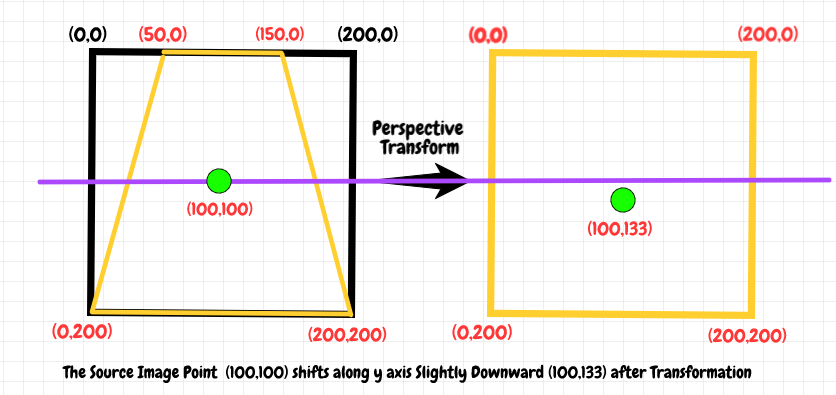

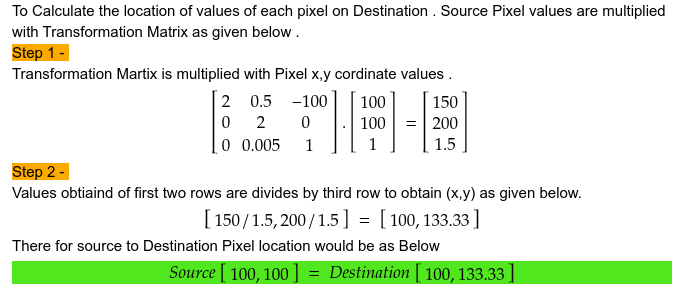

[http://jlouthan.github.io/perspective-transform/examples/test-ui/index.html](http://jlouthan.github.io/perspective-transform/examples/test-ui/index.html)

In [9]:
!wget https://github.com/diplomado-ia-pucp/dava/raw/main/documento.jpg

"wget" no se reconoce como un comando interno o externo,
programa o archivo por lotes ejecutable.


In [10]:
#Leemos la imagen a corregir
img = cv2.imread('documento.jpg')
img = img[:,:,::-1] # rgb

fig = px.imshow(img)
fig.show()

In [11]:
# Definimos los puntos de las esquinas del papel
# Dibujamos los puntos y el poligono en la imagen
puntos = np.float32([[736,1169],[2403,1136],[3067,3775],[144,3829]])

imgDibujo = img.copy()

for i in range(0, 4):
  cv2.circle(imgDibujo, tuple(puntos[i].astype(int)), 30, (255,0,0), -1)

pts = puntos.reshape((-1,1,2))
cv2.polylines(imgDibujo, [pts.astype(np.int32)], True, (0,255,0), thickness=10)

fig = px.imshow(imgDibujo)
fig.show()

In [12]:
width = 500
height = 700

# Realizamos la transformacion
target = np.float32([[0,0],[width,0],[width,height],[0,height]])

matrix = cv2.getPerspectiveTransform(puntos, target)

result = cv2.warpPerspective(img, matrix, (width,height))

fig = px.imshow(result, height=700)
fig.show()

## Tarea

Implementar la función de zoom para una imagen

In [13]:
def zoom(I, factor):
    # Calcular el centro de la imagen
    centro = np.array([I.shape[1] / 2, I.shape[0] / 2])

    # Calcular las dimensiones de la imagen de salida
    dim_salida = (int(I.shape[0] * factor), int(I.shape[1] * factor))

    # Aplicar rotación y obtener la imagen resultante
    zoomed_image = rotarImagen(I, centro, 0, dim_salida)

    return zoomed_image

In [14]:
imagen_zoomed = zoom(im, 1)
px.imshow(imagen_zoomed, binary_string=True).show()

In [15]:
imagen_zoomed = zoom(im, 1.5)
px.imshow(imagen_zoomed, binary_string=True).show()